# Capstone Project — The Battle of Neighborhoods in Taipei: Restaurants

## A. Introduction/Business Understanding

### A.1 Description of the problem
Recently, Veganism has become the most in-vogue dietary trend around the world. More and more people embrace the plan-based lifestyles. Taiwan is not excluded from this fad, especially of its capital, Taipei.

Even though the prospect of vegan dietary seems to be optimistic, the hyper-competitive essence in the catering market shouldn't be neglected.

Under this scenario, **the business problem we are currently posing is:**

*How could we support business partners to find a location that guarantees the higher profit potential of their vegan restaurant investment in Taipei?*

### A.2 Discussion of the Background
As the capital and a special municipality of Taiwan, Taipei is the political, economic, educational, and cultural center of Taiwan as well as one of the major hubs in East Asia with an estimated population of 2.6 million.

Considered to be a global city, Taipei has dozens of world-class restaurants where gourmets can sample from the best traditional Taiwanese cuisine to the wide variety of exotic choices. Aside from that, there are also plenty of night markets serving up scrumptious snacks in an environment of chaotic excitement and fun.

Undoubtedly, food plays an important part in Taipei, and this has further aggravated the competition in catering industry and the discerning taste buds of Taipei people. As a matter of fact, the average annual restaurant close down rate in Taipei is around 30%, which means out of 10 restaurants, there is only 7 survive after a year. Needless to say, if we transform the scope to a longer period, operating a restaurant that generates stable profit is definitely a challenge.

Even though the rising demand for vegan dietary brings profit potential, there are lots of indices that need to be cautiously considered. So, how could we utilize machine learning to find the proper location to start the vegan business? One solution is using clustering method to group different districts by their restaurant category and leverage the result with population data. In this following paragraph, I am going to walk through the whole process of this solution.

## B. Data Requirements
1. `Districts name in Taipei`
* Data source: [Github](https://gist.github.com/vinta/079cb8d4da486f471365c31388ed1b85)
* Description: Using this dictionary combines with [geopy](https://geopy.readthedocs.io/en/stable/) to collect the latitude and longitude data of each district so we can use this geographic data later.
2. `Population for each district`
* Data source: [Taipei City Government- Department of Budget, Accounting and Statistic](https://statdb.dbas.gov.taipei/pxweb2007-tp/dialog/statfile9.asp)
* Description: Population distribution for each district.
3. `Restaurants information in each district`
* Data source: [Foursquare](https://foursquare.com/) APIs
* Description: By using this API we will get all the venues in each district. We can filter these venues to get only restaurants.
4. `Taipei Districts Geojson`
* Data source: [Github](https://github.com/g0v/twgeojson/blob/master/json/twTown1982.geo.json)
* Description: Geojson used for plotting choropleth map with [Folium](https://python-visualization.github.io/folium/).

## C. Methodology

In [1]:
import requests 
import pandas as pd 
import numpy as np 
# import random # library for random number generation

# module to convert an address into latitude and longitude values
from geopy.geocoders import Nominatim 

# # libraries for displaying images
# from IPython.display import Image 
# from IPython.core.display import HTML 
    
# tranforming json file into a dataframe
from pandas.io.json import json_normalize

# basic plotting 
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as colors

# map plotting
import folium
from folium import IFrame
from folium.plugins import HeatMap
from folium.plugins import HeatMapWithTime

In [2]:
area_data = {
    '臺北市': ['中正區', '臺北大同區', '中山區', '萬華區', '信義區', '松山區', '大安區', '南港區', '北投區', '內湖區', '士林區', '文山區'],
    '新北市': ['板橋區', '新莊區', '泰山區', '林口區', '淡水區', '金山區', '八里區', '萬里區', '石門區', '三芝區', '瑞芳區', '汐止區', '平溪區', '貢寮區', '雙溪區', '深坑區', '石碇區', '新店區', '坪林區', '烏來區', '中和區', '永和區', '土城區', '三峽區', '樹林區', '鶯歌區', '三重區', '蘆洲區', '五股區'],
    '基隆市': ['仁愛區', '中正區', '信義區', '中山區', '安樂區', '暖暖區', '七堵區'],
    '桃園市': ['桃園區', '中壢區', '平鎮區', '八德區', '楊梅區', '蘆竹區', '龜山區', '龍潭區', '大溪區', '大園區', '觀音區', '新屋區', '復興區'],
    '新竹縣': ['竹北市', '竹東鎮', '新埔鎮', '關西鎮', '峨眉鄉', '寶山鄉', '北埔鄉', '橫山鄉', '芎林鄉', '湖口鄉', '新豐鄉', '尖石鄉', '五峰鄉'],
    '新竹市': ['東區', '北區', '香山區'],
    '苗栗縣': ['苗栗市', '通霄鎮', '苑裡鎮', '竹南鎮', '頭份鎮', '後龍鎮', '卓蘭鎮', '西湖鄉', '頭屋鄉', '公館鄉', '銅鑼鄉', '三義鄉', '造橋鄉', '三灣鄉', '南庄鄉', '大湖鄉', '獅潭鄉', '泰安鄉'],
    '臺中市': ['中區', '東區', '南區', '西區', '北區', '北屯區', '西屯區', '南屯區', '太平區', '大里區', '霧峰區', '烏日區', '豐原區', '后里區', '東勢區', '石岡區', '新社區', '和平區', '神岡區', '潭子區', '大雅區', '大肚區', '龍井區', '沙鹿區', '梧棲區', '清水區', '大甲區', '外埔區', '大安區'],
    '南投縣': ['南投市', '埔里鎮', '草屯鎮', '竹山鎮', '集集鎮', '名間鄉', '鹿谷鄉', '中寮鄉', '魚池鄉', '國姓鄉', '水里鄉', '信義鄉', '仁愛鄉'],
    '彰化縣': ['彰化市', '員林鎮', '和美鎮', '鹿港鎮', '溪湖鎮', '二林鎮', '田中鎮', '北斗鎮', '花壇鄉', '芬園鄉', '大村鄉', '永靖鄉', '伸港鄉', '線西鄉', '福興鄉', '秀水鄉', '埔心鄉', '埔鹽鄉', '大城鄉', '芳苑鄉', '竹塘鄉', '社頭鄉', '二水鄉', '田尾鄉', '埤頭鄉', '溪州鄉'],
    '雲林縣': ['斗六市', '斗南鎮', '虎尾鎮', '西螺鎮', '土庫鎮', '北港鎮', '莿桐鄉', '林內鄉', '古坑鄉', '大埤鄉', '崙背鄉', '二崙鄉', '麥寮鄉', '臺西鄉', '東勢鄉', '褒忠鄉', '四湖鄉', '口湖鄉', '水林鄉', '元長鄉'],
    '嘉義縣': ['太保市', '朴子市', '布袋鎮', '大林鎮', '民雄鄉', '溪口鄉', '新港鄉', '六腳鄉', '東石鄉', '義竹鄉', '鹿草鄉', '水上鄉', '中埔鄉', '竹崎鄉', '梅山鄉', '番路鄉', '大埔鄉', '阿里山鄉'],
    '嘉義市': ['東區', '西區'],
    '臺南市': ['中西區', '東區', '南區', '北區', '安平區', '安南區', '永康區', '歸仁區', '新化區', '左鎮區', '玉井區', '楠西區', '南化區', '仁德區', '關廟區', '龍崎區', '官田區', '麻豆區', '佳里區', '西港區', '七股區', '將軍區', '學甲區', '北門區', '新營區', '後壁區', '白河區', '東山區', '六甲區', '下營區', '柳營區', '鹽水區', '善化區', '大內區', '山上區', '新市區', '安定區'],
    '高雄市': ['楠梓區', '左營區', '鼓山區', '三民區', '鹽埕區', '前金區', '新興區', '苓雅區', '前鎮區', '小港區', '旗津區', '鳳山區', '大寮區', '鳥松區', '林園區', '仁武區', '大樹區', '大社區', '岡山區', '路竹區', '橋頭區', '梓官區', '彌陀區', '永安區', '燕巢區', '田寮區', '阿蓮區', '茄萣區', '湖內區', '旗山區', '美濃區', '內門區', '杉林區', '甲仙區', '六龜區', '茂林區', '桃源區', '那瑪夏區'],
    '屏東縣': ['屏東市', '潮州鎮', '東港鎮', '恆春鎮', '萬丹鄉', '長治鄉', '麟洛鄉', '九如鄉', '里港鄉', '鹽埔鄉', '高樹鄉', '萬巒鄉', '內埔鄉', '竹田鄉', '新埤鄉', '枋寮鄉', '新園鄉', '崁頂鄉', '林邊鄉', '南州鄉', '佳冬鄉', '琉球鄉', '車城鄉', '滿州鄉', '枋山鄉', '霧台鄉', '瑪家鄉', '泰武鄉', '來義鄉', '春日鄉', '獅子鄉', '牡丹鄉', '三地門鄉'],
    '宜蘭縣': ['宜蘭市', '羅東鎮', '蘇澳鎮', '頭城鎮', '礁溪鄉', '壯圍鄉', '員山鄉', '冬山鄉', '五結鄉', '三星鄉', '大同鄉', '南澳鄉'
    ],
    '花蓮縣': ['花蓮市', '鳳林鎮', '玉里鎮', '新城鄉', '吉安鄉', '壽豐鄉', '秀林鄉', '光復鄉', '豐濱鄉', '瑞穗鄉', '萬榮鄉', '富里鄉', '卓溪鄉'],
    '臺東縣': ['臺東市', '成功鎮', '關山鎮', '長濱鄉', '海端鄉', '池上鄉', '東河鄉', '鹿野鄉', '延平鄉', '卑南鄉', '金峰鄉', '大武鄉', '達仁鄉', '綠島鄉', '蘭嶼鄉', '太麻里鄉'],
    '澎湖縣': ['馬公市', '湖西鄉', '白沙鄉', '西嶼鄉', '望安鄉', '七美鄉'],
    '金門縣': ['金城鎮', '金湖鎮', '金沙鎮', '金寧鄉', '烈嶼鄉', '烏坵鄉'],
    '連江縣': ['南竿鄉', '北竿鄉', '莒光鄉', '東引鄉']
}

In [3]:
pop = pd.read_csv('109年1-12月各區人口數.csv', index_col=0, skiprows=lambda x: x in [0,1,16])
pop.columns = pop.columns.str.strip()
pop.index = pop.index.str.strip()
pop = pop[1:]

### Using Geolocator to retreicve latitude and longitude data

In [4]:
# Create an empty dataframe
taipei_dis = pd.DataFrame(columns=["District", "Latitude", "Longitude"])

# useing loop to append elements into dataframe

for district in area_data['臺北市']:
    address = district
    geolocator = Nominatim(user_agent="foursquare_agent")
    location = geolocator.geocode(address)
    latitude = location.latitude
    longitude = location.longitude
     
    taipei_dis = taipei_dis.append({'District':district, 'Latitude':latitude, 'Longitude':longitude}, ignore_index=True)
    print(latitude, longitude)

25.0323611 121.518267
25.065986 121.515514
25.0643611 121.533468
25.0319327 121.4993322
25.0333448 121.5668963
25.0498852 121.5772719
25.0265152 121.534395
25.0545779 121.6065999
25.132419 121.501379
25.069664 121.5889983
25.0918396 121.5242068
24.989786 121.570458


### Taiwan District List

In [5]:
taipei_dis

,District,Latitude,Longitude
0,中正區,25.032361,121.518267
1,臺北大同區,25.065986,121.515514
2,中山區,25.064361,121.533468
3,萬華區,25.031933,121.499332
4,信義區,25.033345,121.566896
5,松山區,25.049885,121.577272
6,大安區,25.026515,121.534395
7,南港區,25.054578,121.606600
8,北投區,25.132419,121.501379
9,內湖區,25.069664,121.588998


In [6]:
# Taipei latitude and longitude values
Taipei_latitude = 25.0430
Taipei_longitude = 121.5654

# Using 'utf2asc' function to solve Chinese encoding issue
def utf2asc(s):
    return str(str(s).encode('ascii', 'xmlcharrefreplace'))[2:-1]

# create map and display it
taipei_map = folium.Map(location=[Taipei_latitude, Taipei_longitude], zoom_start=11, tiles='cartodbpositron')



# add markers to the map
markers_colors = []
for lat, lon, dis in zip(taipei_dis['Latitude'], taipei_dis['Longitude'], taipei_dis['District']):
    label = folium.Popup(utf2asc(dis)) 

    folium.CircleMarker(
        [lat, lon],
        radius=8,
        popup=label,
        fill=True,
        fill_opacity=0.7).add_to(taipei_map)


taipei_map

### Foursquare API

In [7]:
# Define function to retreive Data
def getNearbyVenues(names, latitudes, longitudes, radius):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['District', 
                  'District Latitude', 
                  'District Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [8]:
CLIENT_ID = 'U0NDUBCR4P4FESRSL3ON0LKCM3VAJRE5CT0BTHTH2J5LR3KE'
CLIENT_SECRET = 'BHTMCOEX0GRPA5NAPX5DQOLK4QTJYIIFV13DLT3AATNBU0TM' 
VERSION = '20200805'

radius = 3000
LIMIT = 100

In [9]:
# Get Taiepi venues data
taipei_venues = getNearbyVenues(names=taipei_dis['District'],
                                latitudes=taipei_dis['Latitude'],
                                longitudes=taipei_dis['Longitude'],
                                radius=radius
                                )

中正區
臺北大同區
中山區
萬華區
信義區
松山區
大安區
南港區
北投區
內湖區
士林區
文山區


In [10]:
pd.set_option('display.max_rows', None)

# Revise the district name which foursquare API return wrong latitude and longtitude if use the original name
taipei_venues.loc[taipei_venues['District']=='臺北大同區', 'District'] = '大同區'

taipei_venues.head(12)

,District,District Latitude,District Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,中正區,25.032361,121.518267,Kinfen Braised Pork Rice (金峰魯肉飯),25.032194,121.518534,Taiwanese Restaurant
1,中正區,25.032361,121.518267,National Theater (國家戲劇院),25.035197,121.518188,Theater
2,中正區,25.032361,121.518267,Chiang Kai-Shek Memorial Hall (中正紀念堂),25.034555,121.521835,Monument / Landmark
3,中正區,25.032361,121.518267,National Concert Hall (國家音樂廳),25.036850,121.519282,Concert Hall
4,中正區,25.032361,121.518267,Ebisu Curry & Coffee,25.030015,121.516384,Japanese Restaurant
5,中正區,25.032361,121.518267,福井麵疙瘩,25.029905,121.515622,Noodle House
6,中正區,25.032361,121.518267,晉江茶堂,25.026389,121.521082,Hakka Restaurant
7,中正區,25.032361,121.518267,Liberty Square Archway (自由廣場牌樓),25.036716,121.517472,Monument / Landmark
8,中正區,25.032361,121.518267,豆味行甜不辣、豆花、芋圓,25.031303,121.517232,Snack Place
9,中正區,25.032361,121.518267,黃家現烤香腸,25.025723,121.513596,Food Truck


### Let's check out the number of different categories restaurant in Taipei

In [11]:
taipei_restaurant = taipei_venues[taipei_venues['Venue Category'].str.contains('Restaurant')]
taipei_restaurant.head()

,District,District Latitude,District Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,中正區,25.032361,121.518267,Kinfen Braised Pork Rice (金峰魯肉飯),25.032194,121.518534,Taiwanese Restaurant
4,中正區,25.032361,121.518267,Ebisu Curry & Coffee,25.030015,121.516384,Japanese Restaurant
6,中正區,25.032361,121.518267,晉江茶堂,25.026389,121.521082,Hakka Restaurant
13,中正區,25.032361,121.518267,野草居食屋 Fireweeds,25.024793,121.521779,Japanese Restaurant
14,中正區,25.032361,121.518267,Din Tai Fung (鼎泰豐),25.033716,121.530127,Dumpling Restaurant


In [12]:
print('There are {} uniques Venue categories in Taiepi.'.format(len(taipei_venues['Venue Category'].unique())))
print('--------------------------------------')
print('There are {} uniques Restaruant categories in Taiepi.'.format(len(taipei_restaurant['Venue Category'].unique())))

There are 166 uniques Venue categories in Taiepi.
--------------------------------------
There are 41 uniques Restaruant categories in Taiepi.


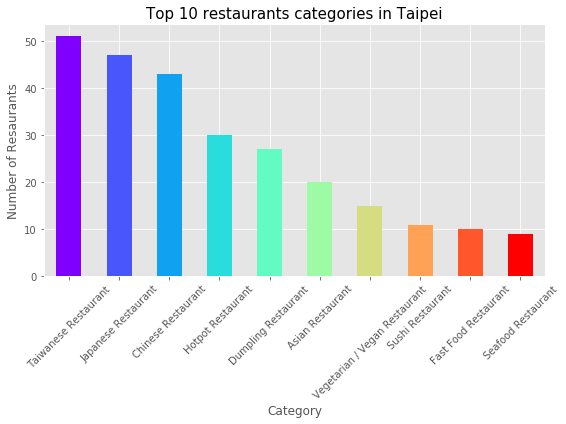

In [13]:
res_category = taipei_restaurant.groupby("Venue Category").count().sort_values('District', ascending = False)
res_category = res_category['District'][:10]

# Assign color for each category
x = np.arange(len(res_category))
ys = [i + x + (i*x)**2 for i in range(len(res_category))]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]


plt.style.use('ggplot')

res_category.plot(kind='bar', figsize=(8,6), color=rainbow )

plt.xlabel('Category', fontsize=12) # add to x-label to the plot
plt.xticks(rotation=45)
plt.ylabel('Number of Resaurants', fontsize=12) # add y-label to the plot
plt.title('Top 10 restaurants categories in Taipei', fontsize=15)
plt.tight_layout()
plt.show()

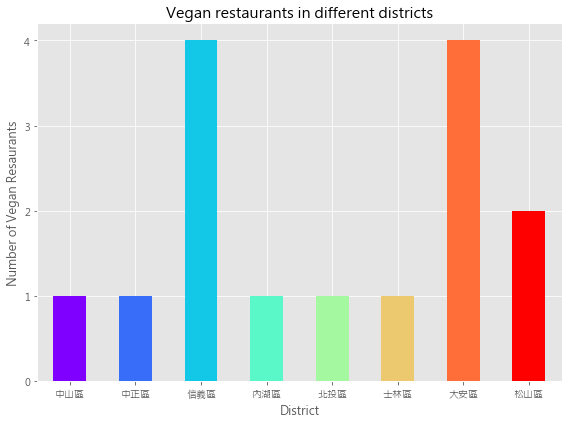

In [14]:
vegan_taipei = taipei_venues[taipei_venues['Venue Category'].str.contains('Vegan')].groupby('District').count()
vegan_taipei = vegan_taipei['Venue Category']

# Assign color for each category
x = np.arange(len(vegan_taipei))
ys = [i + x + (i*x)**2 for i in range(len(vegan_taipei))]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

vegan_taipei.plot(kind='bar', figsize=(8,6), color=rainbow )

plt.rcParams['font.sans-serif'] = ['Microsoft JhengHei'] 
plt.rcParams['axes.unicode_minus'] = False

plt.xlabel('District', fontsize=12) # add to x-label to the plot
plt.xticks(rotation=0) #旋轉 Xticks 標籤文字
plt.ylabel('Number of Vegan Resaurants', fontsize=12) # add y-label to the plot
plt.yticks([0,1,2,3,4])
plt.title('Vegan restaurants in different districts', fontsize=15)
plt.tight_layout()
plt.show()

In [15]:
# one hot encoding
taipei_onehot = pd.get_dummies(taipei_restaurant[['Venue Category']], prefix="", prefix_sep="")

# add neighbourhood column back to dataframe
taipei_onehot['District'] = taipei_restaurant['District'] 

# move neighbourhood column to the first column
fixed_columns = [taipei_onehot.columns[-1]] + list(taipei_onehot.columns[:-1])
taipei_onehot = taipei_onehot[fixed_columns]

taipei_onehot.head()

,District,American Restaurant,Asian Restaurant,Beijing Restaurant,Cambodian Restaurant,Cantonese Restaurant,Chinese Restaurant,Comfort Food Restaurant,Dim Sum Restaurant,Donburi Restaurant,...,Shanxi Restaurant,Spanish Restaurant,Sushi Restaurant,Szechuan Restaurant,Taiwanese Restaurant,Thai Restaurant,Tonkatsu Restaurant,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Xinjiang Restaurant
0,中正區,0,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
4,中正區,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6,中正區,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
13,中正區,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
14,中正區,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [16]:
resaurant_count = taipei_onehot.groupby('District').count().reset_index().sum(axis=1)

taipei_grouped = taipei_onehot.groupby('District').mean().reset_index()
taipei_grouped 

,District,American Restaurant,Asian Restaurant,Beijing Restaurant,Cambodian Restaurant,Cantonese Restaurant,Chinese Restaurant,Comfort Food Restaurant,Dim Sum Restaurant,Donburi Restaurant,...,Shanxi Restaurant,Spanish Restaurant,Sushi Restaurant,Szechuan Restaurant,Taiwanese Restaurant,Thai Restaurant,Tonkatsu Restaurant,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Xinjiang Restaurant
0,中山區,0.022727,0.045455,0.00,0.022727,0.000000,0.113636,0.022727,0.000000,0.000000,...,0.000000,0.000000,0.045455,0.022727,0.181818,0.022727,0.00,0.022727,0.000000,0.000000
1,中正區,0.047619,0.047619,0.00,0.000000,0.000000,0.095238,0.000000,0.095238,0.047619,...,0.000000,0.047619,0.047619,0.047619,0.095238,0.000000,0.00,0.047619,0.000000,0.000000
2,信義區,0.000000,0.040000,0.00,0.000000,0.000000,0.120000,0.000000,0.040000,0.000000,...,0.040000,0.000000,0.040000,0.000000,0.080000,0.000000,0.00,0.160000,0.000000,0.000000
3,內湖區,0.035714,0.071429,0.00,0.000000,0.000000,0.107143,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.071429,0.000000,0.071429,0.035714,0.00,0.035714,0.000000,0.000000
4,北投區,0.000000,0.076923,0.00,0.000000,0.000000,0.269231,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.038462,0.038462,0.038462,0.076923,0.00,0.038462,0.000000,0.000000
5,南港區,0.040000,0.080000,0.04,0.000000,0.000000,0.120000,0.040000,0.000000,0.000000,...,0.000000,0.000000,0.040000,0.040000,0.000000,0.040000,0.04,0.000000,0.000000,0.000000
6,士林區,0.041667,0.000000,0.00,0.000000,0.000000,0.208333,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.166667,0.000000,0.00,0.041667,0.000000,0.000000
7,大同區,0.000000,0.111111,0.00,0.000000,0.027778,0.083333,0.000000,0.000000,0.027778,...,0.000000,0.027778,0.000000,0.000000,0.305556,0.027778,0.00,0.000000,0.000000,0.000000
8,大安區,0.000000,0.027778,0.00,0.000000,0.000000,0.138889,0.000000,0.027778,0.000000,...,0.000000,0.000000,0.027778,0.000000,0.111111,0.027778,0.00,0.111111,0.027778,0.027778
9,文山區,0.000000,0.150000,0.00,0.000000,0.000000,0.100000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.100000,0.000000,0.00,0.000000,0.000000,0.000000


In [17]:
num_top_venues = 3

for hood in taipei_grouped['District']:
    print("----"+hood+"----")
    temp = taipei_grouped[taipei_grouped['District'] == hood].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    print('\n')

----中山區----
                  venue  freq
0   Japanese Restaurant  0.18
1  Taiwanese Restaurant  0.18
2    Chinese Restaurant  0.11


----中正區----
                 venue  freq
0  Japanese Restaurant   0.1
1   Chinese Restaurant   0.1
2   Dim Sum Restaurant   0.1


----信義區----
                           venue  freq
0  Vegetarian / Vegan Restaurant  0.16
1              Hotpot Restaurant  0.12
2             Chinese Restaurant  0.12


----內湖區----
                 venue  freq
0  Japanese Restaurant  0.25
1   Chinese Restaurant  0.11
2    Hotpot Restaurant  0.07


----北投區----
                  venue  freq
0    Chinese Restaurant  0.27
1   Dumpling Restaurant  0.12
2  Fast Food Restaurant  0.08


----南港區----
                  venue  freq
0   Japanese Restaurant  0.28
1    Chinese Restaurant  0.12
2  Fast Food Restaurant  0.12


----士林區----
                  venue  freq
0    Chinese Restaurant  0.21
1     Hotpot Restaurant  0.17
2  Taiwanese Restaurant  0.17


----大同區----
                  venu

In [18]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['District']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Restaurant'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Restaurant'.format(ind+1))

# create a new dataframe
districts_venues_sorted = pd.DataFrame(columns=columns)
districts_venues_sorted['District'] = taipei_grouped['District']

for ind in np.arange(taipei_grouped.shape[0]):
    districts_venues_sorted.iloc[ind, 1:] = return_most_common_venues(taipei_grouped.iloc[ind, :], num_top_venues)

districts_venues_sorted

,District,1st Most Common Restaurant,2nd Most Common Restaurant,3rd Most Common Restaurant,4th Most Common Restaurant,5th Most Common Restaurant,6th Most Common Restaurant,7th Most Common Restaurant,8th Most Common Restaurant,9th Most Common Restaurant,10th Most Common Restaurant
0,中山區,Taiwanese Restaurant,Japanese Restaurant,Chinese Restaurant,Hotpot Restaurant,Dumpling Restaurant,Asian Restaurant,Sushi Restaurant,Seafood Restaurant,American Restaurant,Hakka Restaurant
1,中正區,Chinese Restaurant,Japanese Restaurant,Dumpling Restaurant,Taiwanese Restaurant,Dim Sum Restaurant,Seafood Restaurant,Hakka Restaurant,Donburi Restaurant,Indian Restaurant,American Restaurant
2,信義區,Vegetarian / Vegan Restaurant,Hotpot Restaurant,Chinese Restaurant,Taiwanese Restaurant,Japanese Restaurant,Dumpling Restaurant,Italian Restaurant,Sushi Restaurant,Japanese Curry Restaurant,Seafood Restaurant
3,內湖區,Japanese Restaurant,Chinese Restaurant,Asian Restaurant,Dumpling Restaurant,Taiwanese Restaurant,Sushi Restaurant,Hotpot Restaurant,Korean Restaurant,Mediterranean Restaurant,Fast Food Restaurant
4,北投區,Chinese Restaurant,Dumpling Restaurant,Hotpot Restaurant,Asian Restaurant,Thai Restaurant,Fast Food Restaurant,Korean Restaurant,Japanese Restaurant,French Restaurant,Italian Restaurant
5,南港區,Japanese Restaurant,Chinese Restaurant,Fast Food Restaurant,Asian Restaurant,American Restaurant,Dumpling Restaurant,Ramen Restaurant,Comfort Food Restaurant,Sushi Restaurant,Szechuan Restaurant
6,士林區,Chinese Restaurant,Hotpot Restaurant,Taiwanese Restaurant,Japanese Restaurant,Fast Food Restaurant,American Restaurant,Restaurant,German Restaurant,Mongolian Restaurant,Dumpling Restaurant
7,大同區,Taiwanese Restaurant,Hotpot Restaurant,Asian Restaurant,Japanese Restaurant,Chinese Restaurant,Dumpling Restaurant,Hakka Restaurant,Donburi Restaurant,Restaurant,Seafood Restaurant
8,大安區,Chinese Restaurant,Vegetarian / Vegan Restaurant,Taiwanese Restaurant,Hotpot Restaurant,Japanese Restaurant,Dumpling Restaurant,Italian Restaurant,Xinjiang Restaurant,New American Restaurant,Indian Restaurant
9,文山區,Japanese Restaurant,Asian Restaurant,Dumpling Restaurant,Italian Restaurant,Taiwanese Restaurant,Chinese Restaurant,Fast Food Restaurant,Xinjiang Restaurant,German Restaurant,Indian Restaurant


### Clustering

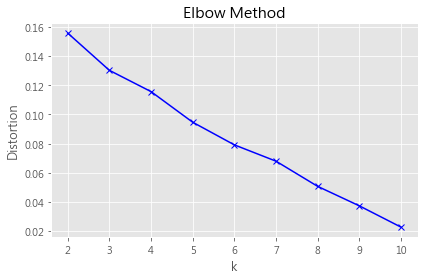

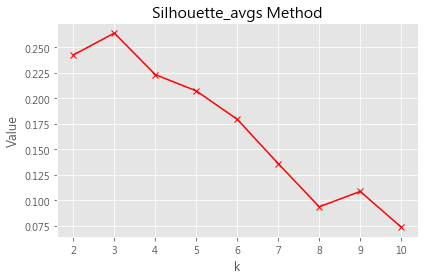

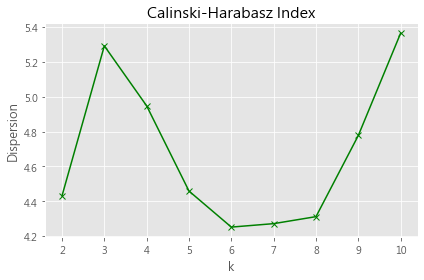

In [19]:
from sklearn.cluster import KMeans
from scipy.spatial.distance import cdist
from sklearn import metrics  

X = taipei_grouped.drop('District', 1)

# Best k
K=range(2,11)

distortions = []
silhouette_avgs = []
calinski_avgs = []
davies_avgs = []

for kclusters in K:
    #Train Model
    kmeans = KMeans(init='k-means++', n_clusters=kclusters, random_state=0, n_init=50).fit(X)
    distortions.append(sum(np.min(cdist(X, kmeans.cluster_centers_, 'euclidean'), axis=1)) / X.shape[0])
    silhouette_avgs.append(metrics.silhouette_score(X, kmeans.labels_))
    calinski_avgs.append(metrics.calinski_harabasz_score(X, kmeans.labels_))
    davies_avgs.append(metrics.davies_bouldin_score(X, kmeans.labels_))
# Plot the elbow
plt.plot(K, distortions, 'bx-')
plt.xlabel('k', fontsize=12)
plt.ylabel('Distortion', fontsize=12)
plt.title('Elbow Method', fontsize=15)
plt.tight_layout()
plt.show()


plt.plot(K, silhouette_avgs, 'bx-', color='r')
plt.xlabel('k', fontsize=12)
plt.ylabel('Value', fontsize=12)
plt.title('Silhouette_avgs Method', fontsize=15)
plt.tight_layout()
plt.show()

plt.plot(K, calinski_avgs, 'bx-', color='g')
plt.xlabel('k', fontsize=12)
plt.ylabel('Dispersion', fontsize=12)
plt.title('Calinski-Harabasz Index', fontsize=15)
plt.tight_layout()
plt.show()

In [20]:
# set number of clusters
kclusters = 3

# run k-means clustering
kmeans = KMeans(init='k-means++', n_clusters=kclusters, random_state=0, n_init=12).fit(X)


# add clustering labels
districts_venues_sorted['Cluster Labels'] = kmeans.labels_

taipei_clustering = taipei_dis
# Revise the district name which foursquare API return wrong latitude and longtitude if use the original name
taipei_clustering.loc[taipei_clustering['District']=='臺北大同區', 'District'] = '大同區'

# merge taipei_grouped with taipei_data to add latitude/longitude for each neighbourhood
taipei_clustering = taipei_clustering.join(districts_venues_sorted.set_index('District'), on='District')


# Adding Total number of restauants and population information 
taipei_clustering["Restaurant Count"] = resaurant_count
taipei_clustering = taipei_clustering.merge(pop.iloc[:,5], left_on="District", right_on=pop.index)
taipei_clustering.rename(columns={'合計':'Population'}, inplace=True)

taipei_clustering # check the last columns!

,District,Latitude,Longitude,1st Most Common Restaurant,2nd Most Common Restaurant,3rd Most Common Restaurant,4th Most Common Restaurant,5th Most Common Restaurant,6th Most Common Restaurant,7th Most Common Restaurant,8th Most Common Restaurant,9th Most Common Restaurant,10th Most Common Restaurant,Cluster Labels,Restaurant Count,Population
0,中正區,25.032361,121.518267,Chinese Restaurant,Japanese Restaurant,Dumpling Restaurant,Taiwanese Restaurant,Dim Sum Restaurant,Seafood Restaurant,Hakka Restaurant,Donburi Restaurant,Indian Restaurant,American Restaurant,1,1804,156746
1,大同區,25.065986,121.515514,Taiwanese Restaurant,Hotpot Restaurant,Asian Restaurant,Japanese Restaurant,Chinese Restaurant,Dumpling Restaurant,Hakka Restaurant,Donburi Restaurant,Restaurant,Seafood Restaurant,0,861,125063
2,中山區,25.064361,121.533468,Taiwanese Restaurant,Japanese Restaurant,Chinese Restaurant,Hotpot Restaurant,Dumpling Restaurant,Asian Restaurant,Sushi Restaurant,Seafood Restaurant,American Restaurant,Hakka Restaurant,1,1025,225712
3,萬華區,25.031933,121.499332,Taiwanese Restaurant,Hotpot Restaurant,Chinese Restaurant,Japanese Restaurant,American Restaurant,Hakka Restaurant,Latin American Restaurant,Ramen Restaurant,Seafood Restaurant,Italian Restaurant,0,1148,184897
4,信義區,25.033345,121.566896,Vegetarian / Vegan Restaurant,Hotpot Restaurant,Chinese Restaurant,Taiwanese Restaurant,Japanese Restaurant,Dumpling Restaurant,Italian Restaurant,Sushi Restaurant,Japanese Curry Restaurant,Seafood Restaurant,1,1066,217569
5,松山區,25.049885,121.577272,Taiwanese Restaurant,Hotpot Restaurant,Japanese Restaurant,Dumpling Restaurant,Chinese Restaurant,Seafood Restaurant,Vegetarian / Vegan Restaurant,Asian Restaurant,Comfort Food Restaurant,Hong Kong Restaurant,1,1025,202326
6,大安區,25.026515,121.534395,Chinese Restaurant,Vegetarian / Vegan Restaurant,Taiwanese Restaurant,Hotpot Restaurant,Japanese Restaurant,Dumpling Restaurant,Italian Restaurant,Xinjiang Restaurant,New American Restaurant,Indian Restaurant,1,984,305389
7,南港區,25.054578,121.606600,Japanese Restaurant,Chinese Restaurant,Fast Food Restaurant,Asian Restaurant,American Restaurant,Dumpling Restaurant,Ramen Restaurant,Comfort Food Restaurant,Sushi Restaurant,Szechuan Restaurant,2,1476,119716
8,北投區,25.132419,121.501379,Chinese Restaurant,Dumpling Restaurant,Hotpot Restaurant,Asian Restaurant,Thai Restaurant,Fast Food Restaurant,Korean Restaurant,Japanese Restaurant,French Restaurant,Italian Restaurant,1,1476,251724
9,內湖區,25.069664,121.588998,Japanese Restaurant,Chinese Restaurant,Asian Restaurant,Dumpling Restaurant,Taiwanese Restaurant,Sushi Restaurant,Hotpot Restaurant,Korean Restaurant,Mediterranean Restaurant,Fast Food Restaurant,2,820,284132


In [21]:
# Taipei latitude and longitude values
Taipei_latitude = 25.0430
Taipei_longitude = 121.5654

# Using 'utf2asc' function to solve Chinese encoding issue
def utf2asc(s):
    return str(str(s).encode('ascii', 'xmlcharrefreplace'))[2:-1]

# create map and display it
map_clusters = folium.Map(location=[Taipei_latitude, Taipei_longitude], zoom_start=11, tiles='cartodbpositron')

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]


# add markers to the map
markers_colors = []
for lat, lon, dis, restaurant, cluster in zip(taipei_clustering['Latitude'], taipei_clustering['Longitude'], taipei_clustering['District'], taipei_clustering['Restaurant Count'], taipei_clustering['Cluster Labels']):
    label = folium.Popup(utf2asc(dis)+'\n/\n' + ' Cluster ' + str(cluster)) 

    folium.CircleMarker(
        [lat, lon],
        radius=restaurant/100,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)


map_clusters

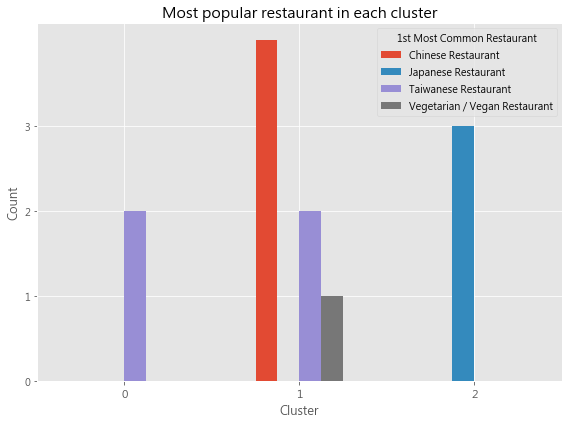

In [22]:
taipei_clustering.groupby(['Cluster Labels', '1st Most Common Restaurant']).count()['Restaurant Count'].unstack().plot(kind='bar', figsize=(8,6))

plt.xlabel('Cluster', fontsize=12) # add to x-label to the plot
plt.xticks(rotation=0, fontsize=11) #旋轉 Xticks 標籤文字
plt.ylabel('Count', fontsize=12) # add y-label to the plot
plt.yticks([0,1,2,3])
plt.title('Most popular restaurant in each cluster', fontsize=15)
plt.tight_layout()
plt.show()

In [23]:


# create map and display it
map_clusters = folium.Map(location=[Taipei_latitude, Taipei_longitude], zoom_start=11.5, tiles='cartodbpositron')

# Create choropleth for population of each district
tw_geo = 'https://raw.githubusercontent.com/g0v/twgeojson/master/json/twTown1982.geo.json'


map_clusters.choropleth(
    geo_data=tw_geo,
    data=taipei_clustering,
    columns=['District', 'Population'],
    key_on='feature.properties.TOWNNAME',
    fill_color='YlGn',
    fill_opacity=0.8,
    line_opacity=0.2,
    legend_name='Population'
)


# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, dis, restaurant, cluster, population in zip(taipei_clustering['Latitude'], taipei_clustering['Longitude'], taipei_clustering['District'], taipei_clustering['Restaurant Count'], taipei_clustering['Cluster Labels'], taipei_clustering['Population']):
    label = folium.Popup(utf2asc(dis)+'\n/\n' +'Restaurant'+ '(' +str(restaurant)+ ')' +'\n/\n'+ 'Population'+'(' + str(population)+')' +'\n/\n'  + 'Cluster'+ str(cluster))  

    folium.CircleMarker(
        [lat, lon],
        radius=restaurant/100,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)


map_clusters

## D. Results

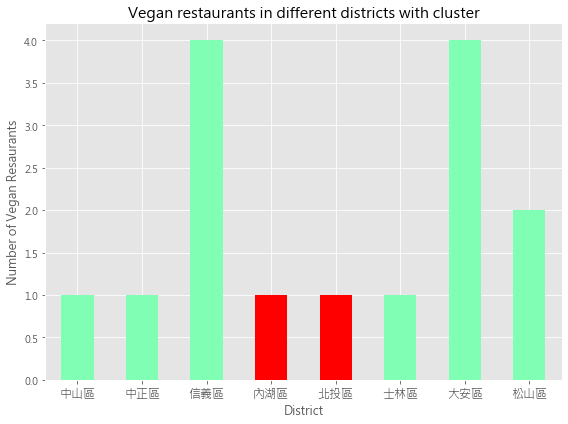

In [24]:
# Replot the Vegan restaurant figure
vegan_taipei.plot(kind='bar', figsize=(8,6), color=['#80ffb4', '#80ffb4','#80ffb4', '#ff0000', '#ff0000', '#80ffb4', '#80ffb4', '#80ffb4'])

plt.xlabel('District', fontsize=12) # add to x-label to the plot
plt.xticks(rotation=0, fontsize=12) #旋轉 Xticks 標籤文字
plt.ylabel('Number of Vegan Resaurants', fontsize=12) # add y-label to the plot
plt.title('Vegan restaurants in different districts with cluster', fontsize=15)
plt.tight_layout()
plt.show()